# Задача 3. Аналитическое решение, сходимость

## Постановка задачи

Для приведенного в задаче 1 волнового уравнения возьмем аналитическое решение в виде:

$$
u(t, x) = r^{(1 - d) / 2}U(c(t + \tau_0) - r)
$$
где $U$ - достаточно гладкая финитная функция. 

В результате получим:

$$
\frac{\partial^{2} u}{\partial t^{2}} - c^{2}\frac{1}{r^{d-1}}
\frac{\partial}{\partial r}(r^{d-1}\frac{\partial u}{\partial r}) = 
c^2 \frac{(d-1)(d-3)}{4r^{(d+3)/2}}U
$$

Граничные условия: 

$$
\frac{\partial u}{\partial r} = \frac{1-d}{2}r^{-(1+d)/2}U(c(t + \tau_0) - r) - 
r^{(1-d)/2}U'(c(t + \tau_0) - r)
$$

Начальные условия:

$$
u(0, r) = r^{(1-d)/2}U(c\tau_0 - r), \qquad
u(\tau, r) = r^{(1-d)/2}U(c(\tau + \tau_0) - r)
$$

Проверка точности решения:
$$
\frac{\big\| u_h - u\big\|}{\big\| u_{\alpha h} - u\big\|} \approx 
\frac{1}{\alpha ^2}
$$

В своей реализации в качестве $U$ я брал функцию "шапочка" из первой задачи.  
Кратность сеток я брал $\alpha = 3$: $N = 200, 600$  
Сперва приведу результаты вычислений, выводы и код будут в конце.

### d = 1

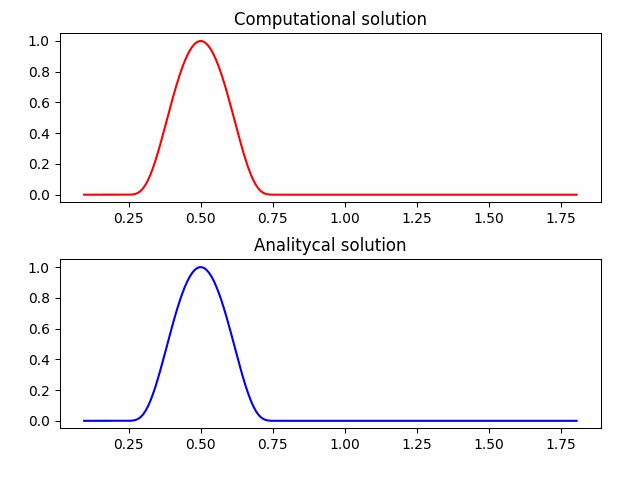

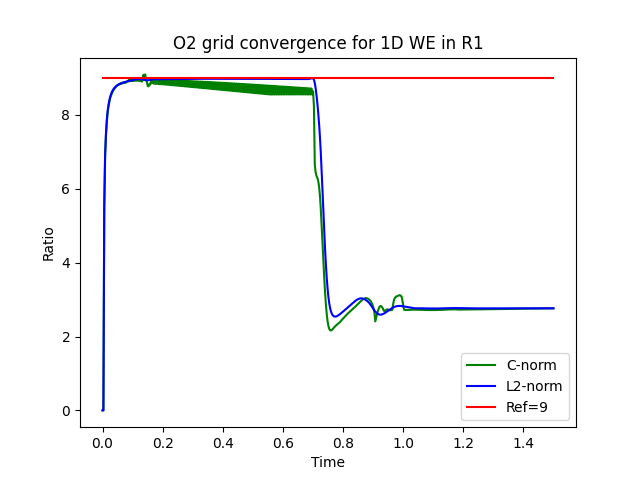

### d = 2

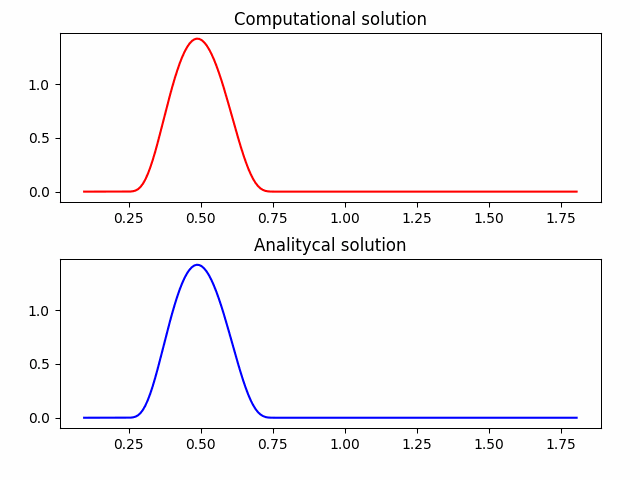

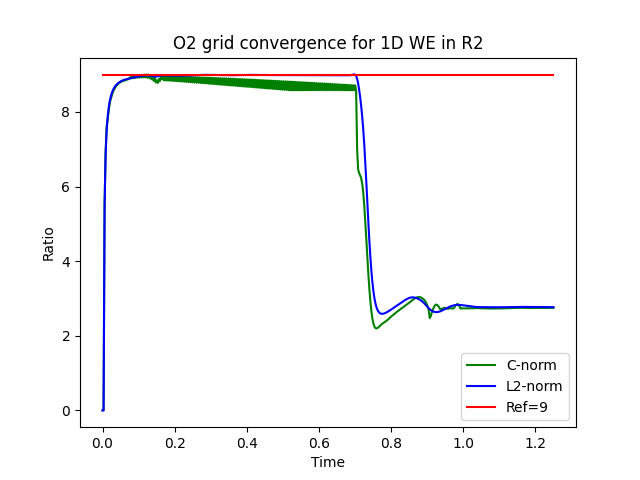

### d = 3

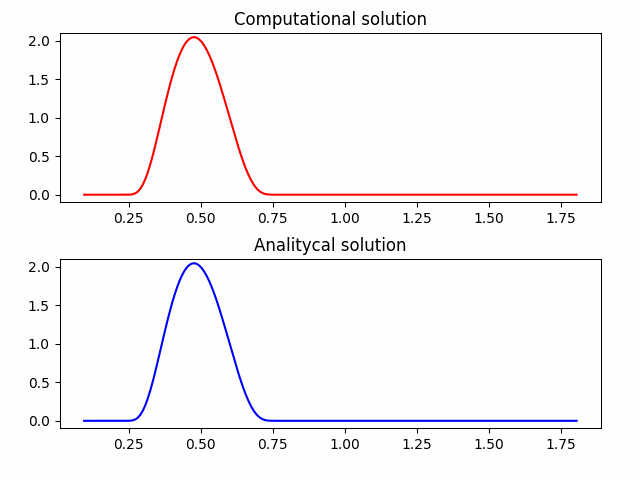

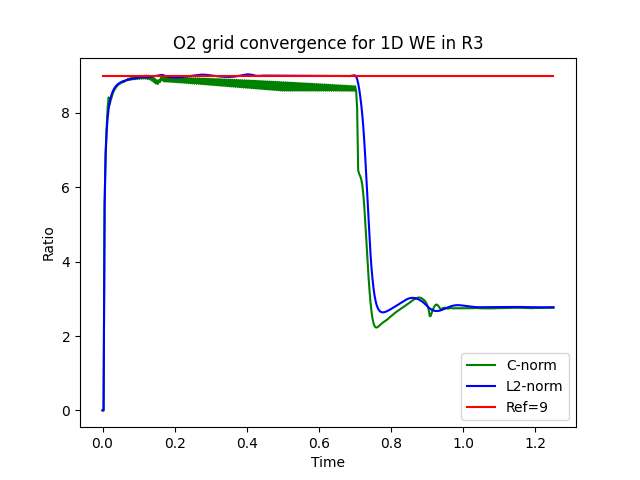

## Выводы:

Из графиков видно, что сама разностная схема сходится к аналитическому решению со вторым порядком, но граничные условия выполняются с первым порядком. Причину этого у меня пока что не получилось выяснить, так как для производной в ГУ я использовал схему центральной разности, которая должна давать второй порядок сходимости.  

Есть предположение, что в этом может быть виноват каким-либо образом модуль sympy, который я использовал для вычисления производной функции "шапочка". В разностной схеме производная не используется, только в ГУ. И также полгода назад в другой задаче у меня не выполнялся второй порядок сходимости и я помню, что там же использовал sympy.  
Чуть позже вероятно посчитаю вручную производную функции $U$ и проверю эту теорию.

Для наглядности приведу исполняемый код:

### Расчет для N = 200 и сравнение с аналитическим решением:

In [58]:
%matplotlib notebook

In [59]:
import numpy as np
import matplotlib.pyplot as plt
import sympy as sym
import matplotlib.animation as animation

In [60]:
def inbetweenAB(a, b, x):
    if x > a and x < b:
        return True
    else:
        return False

In [61]:
rmin, rmax = 0.1, 1.8
c = 1.5
a, b = 0.6, 1.2
courant = 0.5
TIME = 1.25

d = 3

In [1]:
N = 200

h = (rmax - rmin) / N
tau = courant * h / c
T = int(TIME / tau)
print(f"T = {T}\n")

r_grid = np.linspace(rmin - h / 2, rmax + h / 2, N + 2)

NameError: name 'rmax' is not defined

In [63]:
r = sym.symbols("r")

# \tau_0, here 0.5 is location of U.max:
t0 = ((b + a) / 2 + 0.5) / c

# Make function U and U' with sympy:

U_fun_expr = sym.exp(-4 * (2*r - (a + b))**2 / ((b - a)**2 - (2*r - (a + b))**2))
U_fun = sym.lambdify(r, U_fun_expr, "numpy")

U_der_expr = sym.diff(U_fun_expr, r)
U_der_fun = sym.lambdify(r, U_der_expr, "numpy")

#### Комментарий по коду

Так как функция "шапочка" задается системой, я ввел функцию *inbetweenAB()*.

В ячейке ниже выполняется сам расчет. Двумя комментариями ``` #Border conditions ``` отмечен участок с ГУ. Для производной я использовал центральную разность для точек *rmin* и *rmax*:

$$
\frac{u[1] - u[0]}{h} = \frac{1-d}{2}r^{-(1+d)/2}U(c(t + \tau_0) - rmin) - 
r^{(1-d)/2}U'(c(t + \tau_0) - rmin)
$$

$$
\frac{u[N+1] - u[N]}{h} = \frac{1-d}{2}r^{-(1+d)/2}U(c(t + \tau_0) - rmax) - 
r^{(1-d)/2}U'(c(t + \tau_0) - rmax)
$$

In [64]:
u_prev = np.zeros(N + 2)
for i in range(N + 2):
    if inbetweenAB(a, b, c*t0 - r_grid[i]):
        u_prev[i] = r_grid[i]**((1-d)/2) * U_fun(c*t0 - r_grid[i])

u_n = np.zeros(N + 2)
for i in range(N + 2):
    if inbetweenAB(a, b, c*(tau + t0) - r_grid[i]):
        u_n[i] = r_grid[i]**((1-d)/2) * U_fun(c*(tau + t0) - r_grid[i])

u_next = np.zeros(N + 2)

U_answer = np.zeros((T + 1, N + 2))
U_answer[0] = u_prev.copy()
U_answer[1] = u_n.copy()

for n in range(1, T):
    for i in range(1, N + 1):
        if inbetweenAB(a, b, c*(n*tau + t0) - r_grid[i]):
            U_in = U_fun(c*(n*tau + t0) - r_grid[i])
        else:
            U_in = 0

        u_next[i] = 2*u_n[i] - u_prev[i] + (tau*c)**2 / (h*r_grid[i]**(d - 1)) * \
        (((r_grid[i] + r_grid[i + 1]) / 2)**(d - 1) * (u_n[i + 1] - u_n[i]) / h - \
        ((r_grid[i] + r_grid[i - 1]) / 2)**(d - 1) * (u_n[i] - u_n[i - 1]) / h) + \
        tau**2 * c**2 * (d-1)*(d-3) * U_in / (4 * r_grid[i]**((d+3)/2))
    
    # Border conditions
    if inbetweenAB(a, b, c*(n*tau + t0) - rmin):
        u_next[0] = u_next[1] - h * ((1-d)/2 * rmin**(-(1+d)/2) * U_fun(c*(n*tau + t0) - rmin) - \
        rmin**((1-d)/2) * U_der_fun(c*(n*tau + t0) - rmin))
    else:
        u_next[0] = u_next[1]

    if inbetweenAB(a, b, c*(n*tau + t0) - rmax):
        u_next[N + 1] = u_next[N] + h * ((1-d)/2 * rmax**(-(1+d)/2) * U_fun(c*(n*tau + t0) - rmax) - \
        rmax**((1-d)/2) * U_der_fun(c*(n*tau + t0) - rmax))
    else:
        u_next[N + 1] = u_next[N]
    # Border conditions
        
    u_prev = u_n.copy()
    u_n = u_next.copy()
    u_next = np.zeros(N + 2)
    U_answer[n + 1] = u_n.copy()

#     if n % 50 == 0: print(f"n = {n}\n")

Отображение результатов вместе с аналитическим решением:

<IPython.core.display.Javascript object>


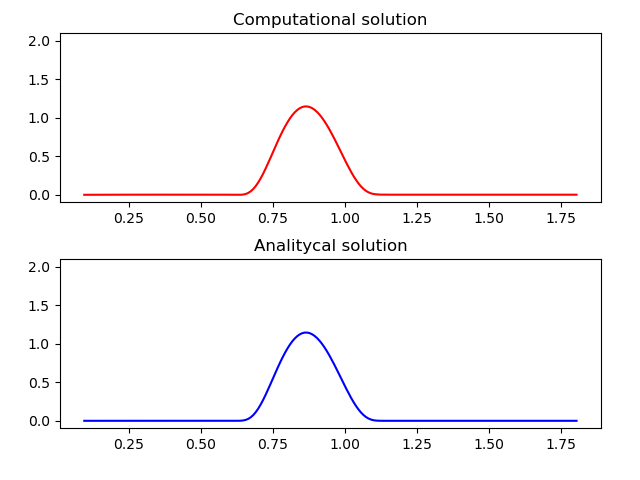

In [65]:
fig, ax = plt.subplots(2, 1)
fig.tight_layout(pad=2)

ymin = -0.1
ymax = np.max(U_answer) + 0.05

for oneax in ax:
    oneax.set_ylim((ymin, ymax))

line1, = ax[0].plot([], [], color="r")
line2, = ax[1].plot([], [], color="b")
line = [line1, line2]

def animate_comp(n):
    ax[0].clear()
    ax[0].set_title("Computational solution")

    ax[1].clear()
    ax[1].set_title("Analitycal solution")

    for oneax in ax:
        oneax.set_ylim((ymin, ymax))

    U_out = np.zeros(N + 2)
    for i in range(N + 2):
        if inbetweenAB(a, b, c*(n*tau + t0) - r_grid[i]):
            U_out[i] = U_fun(c*(n*tau + t0) - r_grid[i])
    
    line[0] = ax[0].plot(r_grid, U_answer[n], "r")
    line[1] = ax[1].plot(r_grid, r_grid**((1-d)/2) * U_out, "b")
    if n % 50 == 0: print(n)
    return line

interval_animation = 10
repeat_animation = True
computational_sol = animation.FuncAnimation(fig, 
                                      animate_comp, 
                                      np.arange(T + 1),
                                      interval = interval_animation,
                                      repeat = repeat_animation)

plt.show()

### Расчет для N = 600 и график сходимости:

In [66]:
U200 = U_answer.copy()

In [67]:
N = 600
h = (rmax - rmin) / N
tau = courant * h / c
T = int(TIME / tau)
print(f"T = {T}\n")

r_grid = np.linspace(rmin - h / 2, rmax + h / 2, N + 2)

T = 1323



In [68]:
u_prev = np.zeros(N + 2)
for i in range(N + 2):
    if inbetweenAB(a, b, c*t0 - r_grid[i]):
        u_prev[i] = r_grid[i]**((1-d)/2) * U_fun(c*t0 - r_grid[i])
# u_prev = r_grid**((1-d)/2) * U_fun(c*t0 - r_grid)

u_n = np.zeros(N + 2)
for i in range(N + 2):
    if inbetweenAB(a, b, c*(tau + t0) - r_grid[i]):
        u_n[i] = r_grid[i]**((1-d)/2) * U_fun(c*(tau + t0) - r_grid[i])
# u_n = r_grid**((1-d)/2) * U_fun(c*(tau + t0) - r_grid)

u_next = np.zeros(N + 2)

U_answer = np.zeros((T + 1, N + 2))
U_answer[0] = u_prev.copy()
U_answer[1] = u_n.copy()

for n in range(1, T):
    for i in range(1, N + 1):
        if inbetweenAB(a, b, c*(n*tau + t0) - r_grid[i]):
            U_in = U_fun(c*(n*tau + t0) - r_grid[i])
        else:
            U_in = 0

        u_next[i] = 2*u_n[i] - u_prev[i] + (tau*c)**2 / (h*r_grid[i]**(d - 1)) * \
        (((r_grid[i] + r_grid[i + 1]) / 2)**(d - 1) * (u_n[i + 1] - u_n[i]) / h - \
        ((r_grid[i] + r_grid[i - 1]) / 2)**(d - 1) * (u_n[i] - u_n[i - 1]) / h) + \
        tau**2 * c**2 * (d-1)*(d-3) * U_in / (4 * r_grid[i]**((d+3)/2))
    
    # Border conditions    
    if inbetweenAB(a, b, c*(n*tau + t0) - rmin):
        u_next[0] = u_next[1] - h * ((1-d)/2 * rmin**(-(1+d)/2) * U_fun(c*(n*tau + t0) - rmin) - \
        rmin**((1-d)/2) * U_der_fun(c*(n*tau + t0) - rmin))
    else:
        u_next[0] = u_next[1]

    if inbetweenAB(a, b, c*(n*tau + t0) - rmax):
        u_next[N + 1] = u_next[N] + h * ((1-d)/2 * rmax**(-(1+d)/2) * U_fun(c*(n*tau + t0) - rmax) - \
        rmax**((1-d)/2) * U_der_fun(c*(n*tau + t0) - rmax))
    else:
        u_next[N + 1] = u_next[N]
    # Border conditions
        
    u_prev = u_n.copy()
    u_n = u_next.copy()
    u_next = np.zeros(N + 2)
    U_answer[n + 1] = u_n.copy()

#     if n % 50 == 0: print(f"n = {n}\n")

U600 = U_answer.copy()

In [69]:
print(f"U200 shape = {np.shape(U200[:, 1:-1])}")
print(f"U600 shape = {np.shape(U600[:-1:3, 2::3])}")

U200 shape = (442, 200)
U600 shape = (441, 200)


<IPython.core.display.Javascript object>


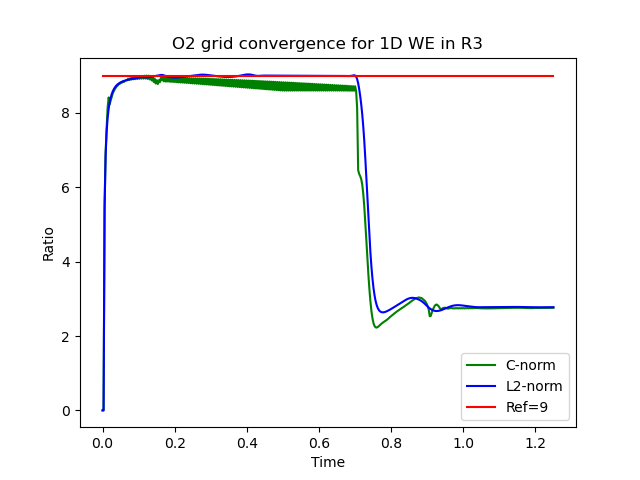

In [70]:
NStart = 200
h = (rmax - rmin) / NStart
tau = courant * h / c
T = int(TIME / tau)

r_grid = np.linspace(rmin - h / 2, rmax + h / 2, NStart + 2)

T = min(np.shape(U200[:, 1:-1])[0], np.shape(U600[:-1:3, 2::3])[0])

conv_C = np.zeros(T + 1)
conv_L2 = np.zeros(T + 1)
for n in range(T + 1):
    U_analit = np.zeros(NStart + 2)
    for i in range(NStart + 2):
        if inbetweenAB(a, b, c*(n*tau + t0) - r_grid[i]):
            U_analit[i] = U_fun(c*(n*tau + t0) - r_grid[i])
    
    conv_C[n] = np.max(np.abs(U200[n, 1:-1] - r_grid[1:-1]**((1-d)/2) * U_analit[1:-1])) / \
        np.max(np.abs(U600[3*n, 2::3] - r_grid[1:-1]**((1-d)/2) * U_analit[1:-1]))
    # removed h 
    conv_L2[n] = np.sqrt(np.sum((U200[n, 1:-1] - r_grid[1:-1]**((1-d)/2) * U_analit[1:-1])**2)) / \
        np.sqrt(np.sum((U600[3*n, 2::3] - r_grid[1:-1]**((1-d)/2) * U_analit[1:-1])**2))

fig = plt.figure()
# fig.set_label(f"O2 grid convergence for 1D WE in R{d}")
ax = plt.subplot()
time_grid = np.linspace(0, TIME, T + 1)
ax.plot(time_grid, conv_C, "g", label="C-norm")
ax.plot(time_grid, conv_L2, "b", label="L2-norm")
ax.plot(time_grid, 9*np.ones(T + 1), "r", label="Ref=9")
ax.set_xlabel("Time")
ax.set_ylabel("Ratio")
plt.title(f"O2 grid convergence for 1D WE in R{d}")

plt.legend()
plt.show()    

Код достаточно грязный, так как здесь собрано несколько разных файлов, которые я писал в разное время.  
Главное здесь - помеченный участок ``` #Border conditions ``` в расчетных ячейках.